In [1]:
import numpy as np
import matplotlib.pyplot as plt 
from mpl_toolkits.mplot3d import Axes3D
import scipy as sp
from scipy import spatial
import os

N_realisation = 2
np.random.seed(N_realisation)  

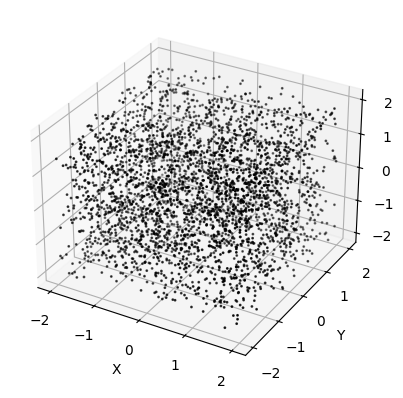

In [2]:
N0_particle = 15 ** 3

XP0 = np.random.uniform(-2, 2, N0_particle) 
YP0 = np.random.uniform(-2, 2, N0_particle)
ZP0 = np.random.uniform(-2, 2, N0_particle)

St0 = 1
R0 = 1
R_collision = 0.05

xl, xr = -2, 2
yl, yr = -2, 2
zd, zu = -2, 2

dx_col, dy_col, dz_col = 1, 1, 1
Nx_col, Ny_col, Nz_col = 4, 4, 4
gridA_xc, gridA_yc, gridA_zc = np.meshgrid(np.linspace(xl+dx_col/2, xr-dx_col/2, Nx_col), 
                                           np.linspace(yl+dy_col/2, yr-dy_col, Ny_col), 
                                           np.linspace(zd+dz_col/2, zu-dz_col/2, Nz_col), indexing='ij')
gridB_xc, gridB_yc, gridB_zc = np.meshgrid(np.linspace(xl, xr, Nx_col+1), np.linspace(yl, yr, Ny_col+1), np.linspace(zd, zu, Nz_col+1), indexing='ij')

# Plot grid lines
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# # Plot lines along x-axis
# for i in range(Ny_col):
#     for j in range(Nz_col):
#         ax.plot(gridA_xc[:, i, j], gridA_yc[:, i, j], gridA_zc[:, i, j], color='r',linestyle='--')

# # Plot lines along y-axis
# for i in range(Nx_col):
#     for j in range(Nz_col):
#         ax.plot(gridA_xc[i, :, j], gridA_yc[i, :, j], gridA_zc[i, :, j], color='g',linestyle='--')


# # Plot lines along z-axis
# for i in range(Nx_col):
#     for j in range(Ny_col):
#         ax.plot(gridA_xc[i, j, :], gridA_yc[i, j, :], gridA_zc[i, j, :], color='b',linestyle='--')


ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.scatter(XP0, YP0, ZP0,s=1, c='k', marker='o')


plt.show()

In [3]:
Bubbles_df_ini = np.zeros((N0_particle, 15), dtype=np.float64)

# first column is bubbles ID
Bubbles_df_ini[:, 0] = np.arange(N0_particle)

# second column is bubbles X position
Bubbles_df_ini[:, 1] = XP0.flatten().astype(float)

# third column is bubbles Y position   
Bubbles_df_ini[:, 2] = YP0.flatten().astype(float)

# fourth column is bubbles Z position
Bubbles_df_ini[:, 3] = ZP0.flatten().astype(float)

# fourth column is bubbles x-velocity
Bubbles_df_ini[:, 4] = np.zeros(N0_particle)

# fifth column is bubbles y-velocity
Bubbles_df_ini[:, 5] = np.zeros(N0_particle)

# sixth column is bubbles z-velocity
Bubbles_df_ini[:, 6] = np.zeros(N0_particle)

# sixth column is bubbles Stokes number
Bubbles_df_ini[:, 7] = St0

# seventh column is bubbles slaved status
Bubbles_df_ini[:, 8] = False

# eighth column is bubbles gridA x-index
Bubbles_df_ini[:, 9] = np.floor((Bubbles_df_ini[:, 1] - xl ) / dx_col).astype(int)

# ninth column is bubbles gridA y-index
Bubbles_df_ini[:, 10] = np.floor((Bubbles_df_ini[:, 2] - yl ) / dy_col).astype(int)

# tenth column is bubbles gridA z-index
Bubbles_df_ini[:, 11] = np.floor((Bubbles_df_ini[:, 3] - zd ) / dz_col).astype(int)

# tenth column is bubbles gridB x-index
Bubbles_df_ini[:, 12] = np.floor((Bubbles_df_ini[:, 1]- xl + dx_col / 2) / dx_col).astype(int)

# eleventh column is bubbles gridB y-index	
Bubbles_df_ini[:, 13] = np.floor((Bubbles_df_ini[:, 2]- yl + dy_col / 2) / dy_col).astype(int)

# twelfth column is bubbles gridB z-index
Bubbles_df_ini[:, 14] = np.floor((Bubbles_df_ini[:, 3]- zd + dz_col / 2) / dz_col).astype(int)

# ditch the ones about to leave the domain 
Bubbles_df_ini = Bubbles_df_ini[(Bubbles_df_ini[:, 1] >= xl) & (Bubbles_df_ini[:, 1] < xr) 
                                & (Bubbles_df_ini[:, 2] >= yl) & (Bubbles_df_ini[:, 2] < yr)
                                & (Bubbles_df_ini[:, 3] >= zd) & (Bubbles_df_ini[:, 3] < zu)]

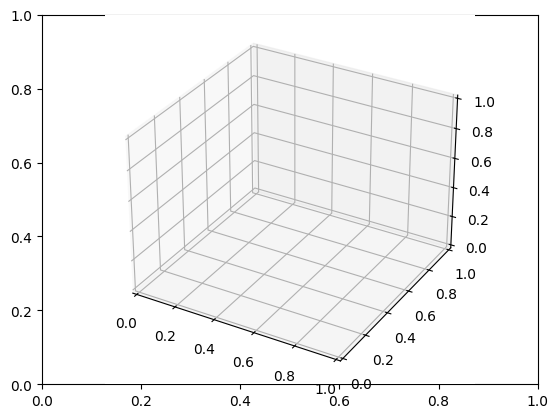

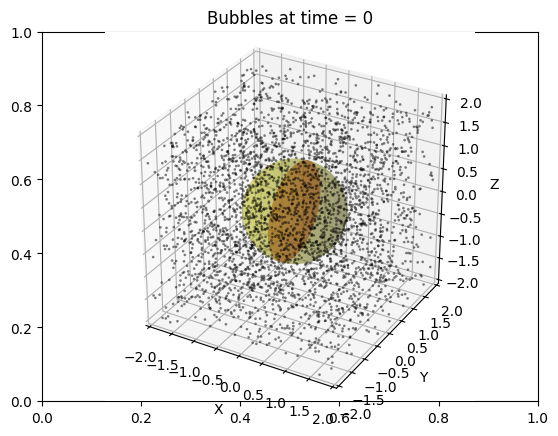

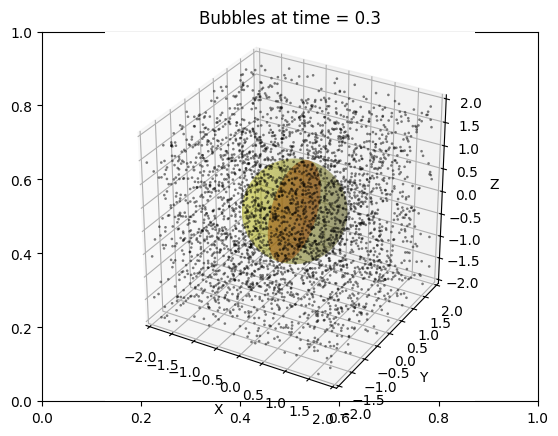

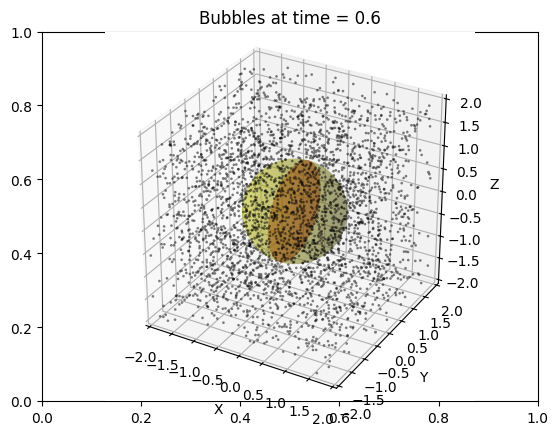

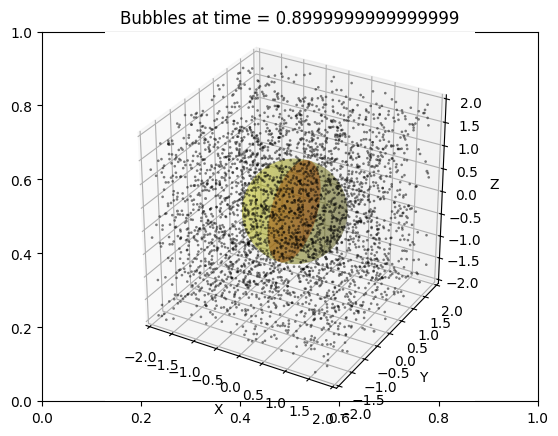

...

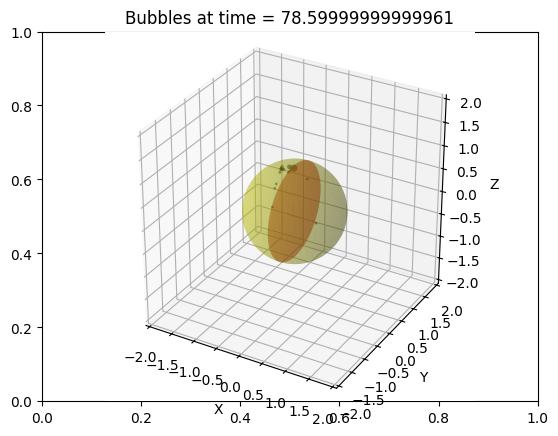

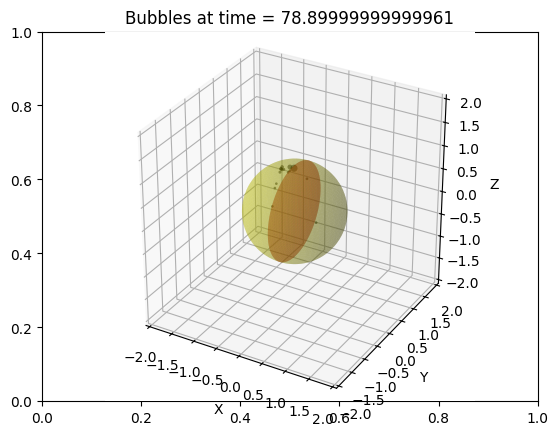

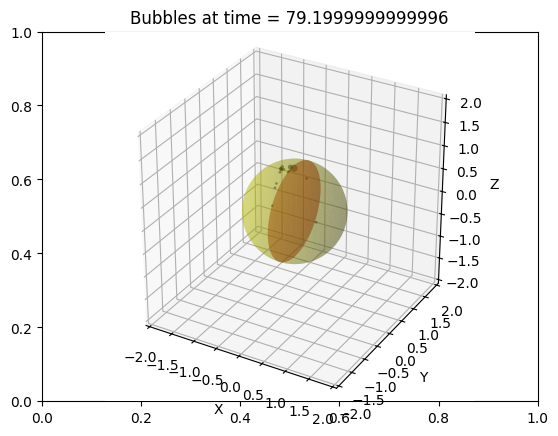

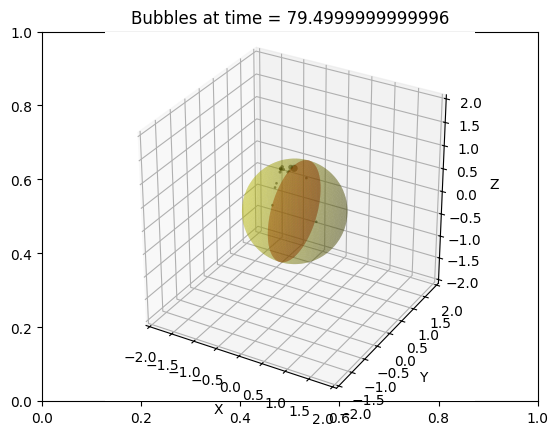

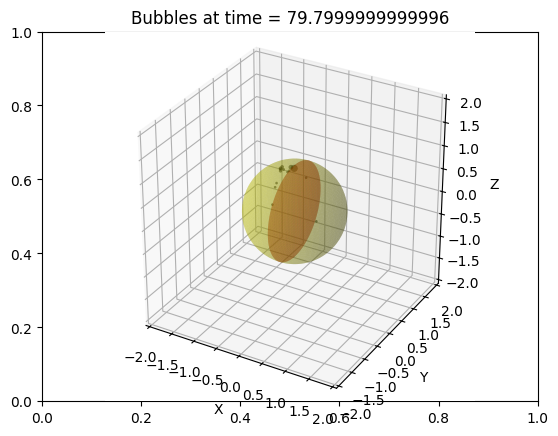

In [4]:
import merge_bubbles_3d as merge
from matplotlib.colors import hsv_to_rgb
import parallel_advect_bubbles_3d as pab3d


tNow = 0
dt = 0.3
tEnd = 80

N_tot = int((tEnd - tNow) / dt + 1)
N_mergeCycle = 0
N_feedCycle = N_tot
Nbub_already_supplemented = 0

Bubbles_df_after_merge = Bubbles_df_ini.copy()
# Res_df_ini

V, H = np.mgrid[0:1:501j, 0:1:501j]
colors_hsv = np.dstack((H, np.ones_like(H), V))
colors_rgb = hsv_to_rgb(colors_hsv)

fig, ax = plt.subplots()
ax = fig.add_subplot(111, projection='3d')

collision_series = []
folder_path = 'noInflux_random_sims/temp'

while tNow < tEnd:

    Bubbles_df_to_adv = Bubbles_df_after_merge.copy()
    # updated_states = np.asarray(pab3d.main(initial_states=Bubbles_df_to_adv[:, 1:7], t0=tNow, tf=tNow+dt), dtype=np.float64).T
    # not sure
    updated_states = np.asarray(pab3d.main(initial_states=Bubbles_df_to_adv[:, 1:8], t0=tNow, tf=tNow+dt), dtype=np.float64).T

    Bubbles_df_before_merge = Bubbles_df_to_adv.copy()
    
    Bubbles_df_after_merge, collision_list = merge.merge_package(Bubbles_df_before_merge=Bubbles_df_to_adv, advected_states=updated_states, 
                                             gridA_size=gridA_xc.shape, gridB_size=gridB_xc.shape, boundaries=(xl, xr, yl, yr, zd, zu), cell_size=(dx_col, dy_col, dz_col),
                                             R_collision=R_collision, merge_method='volume-weighted', a=R0, timeNow=tNow, this_ax=ax, color=colors_rgb[N_mergeCycle, N_mergeCycle, :])
    
    collision_series.append(collision_list)
    tNow += dt
    N_mergeCycle += 1

    plt.savefig(folder_path + '/timestep_{}.png'.format(N_mergeCycle), dpi=300)
    np.save(os.path.join(folder_path, 'frame_{}.npy'.format(N_mergeCycle)), Bubbles_df_after_merge[:, 1:8])
    plt.show()

In [7]:
import pickle

file_path = os.path.join(folder_path, 'collision_series.pkl')

with open(file_path, 'wb') as f:
    pickle.dump(collision_series, f)

collision heatmap

In [6]:
# collision_box = {(x, y, z): 0 for x in range(101) for y in range(101) for z in range(101)}

# for collision in collision_series:
#     x_s = np.asarray([c[0] for c in collision])
#     y_s = np.asarray([c[1] for c in collision])
#     z_s = np.asarray([c[2] for c in collision])
#     j_s = np.floor((x_s - xl) / 0.04).astype(int)
#     i_s = np.floor((y_s - yl) / 0.04).astype(int)
#     k_s = np.floor((z_s - zd) / 0.04).astype(int)

#     coordinates = np.column_stack((i_s, j_s, k_s))

#     unique_coords, counts = np.unique(coordinates, axis=0, return_counts=True)

#     # create a dictionary 
#     coll_box_counts = dict(zip(map(tuple, unique_coords), counts))

#     for (i, j, k), count in coll_box_counts.items():
#         collision_box[(i, j, k)] += count

# counts_array = np.array(list(collision_box.values())).reshape(101, 101, 101).astype(float)
# counts_array /= np.max(counts_array)


# import pyvista as pv
# volume = pv.wrap(counts_array)
# # Plot the volume
# plotter = pv.Plotter()
# plotter.add_volume(volume, cmap="viridis")
# plotter.show()